## Build MRCNN Model -Load MRCNN and FCN weights - Load Training Files  
Pass data through MRCNN and then FCN and investigte output values from FCN
- First we generate the heatmaps, and also visually cehck them. 
- the we pass the heatmaps to the routine that prodcues the scores 


 
     train
         image_ids[:10]       :  [262145, 262146, 524291, 131074, 393221, 131075, 393223, 393224, 524297, 9]
         image_ids[1000:1010] :  [1451, 132523, 1453, 132527, 263599, 132529, 132528, 263603, 263604, 132533]
     val35k
      image_ids[:10]       :  [262148, 393225, 131089, 262161, 262162, 393243, 262175, 131108, 393254, 42]
      image_ids[1000:1010] :  [134290, 527506, 527504, 134288, 527510, 265372, 265374, 265378, 527529, 3244]

In [24]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
    
import numpy as np
# import matplotlib as plt
import mrcnn.utils     as utils
import mrcnn.visualize as visualize
from mrcnn.prep_notebook import build_fcn_training_pipeline, run_mrcnn_training_pipeline, run_fcn_training_pipeline
from mrcnn.prep_notebook import build_fcn_inference_pipeline, build_mrcnn_inference_pipeline,run_mrcnn_detection
from mrcnn.visualize     import display_training_batch
from mrcnn.prep_notebook import get_inference_batch, get_image_batch, run_mrcnn_detection, run_fcn_detection
from mrcnn.coco          import prep_coco_dataset

# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_2298.h5' 
WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5'
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_coco "
input_parms +=" --fcn_logs_dir   train_fcn8_bce " 
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      " + WEIGHT_FILE + "  "
# input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   4"
# input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 "
input_parms +=" --coco_classes       78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "

args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)

# mrcnn_model, fcn_model = build_fcn_inference_pipeline(args = args)
mrcnn_model, fcn_model = build_fcn_training_pipeline(args = args)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Current working dir:  E:\git_projs\MRCNN3\notebooks

Arguments passed :
--------------------
batch_size                     1
coco_classes                   [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
epochs                         1
fcn_arch                       FCN8
fcn_layers                     ['all']
fcn_logs_dir                   train_fcn8_bce
fcn_losses                     fcn_BCE_loss
fcn_model                      F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5
last_epoch                     0
lr                             0.001
mrcnn_exclude_layers           None
mrcnn_logs_dir                 train_mrcnn_coco
mrcnn_model                    last
new_log_folder                 False
opt                            ADAGRAD
scale_factor                   4
steps_in_epoch                 1
sysout                   

    prob_grid_clipped      :  (?, 256, 256)
    old_style_scores       :  (1, 81, 200, 3)  Keras tensor  False
    alt_scores_1    :  (None, 3)  Keras tensor  False
    alt_scores_1(by class)       :  (1, 81, 200, 3)  Keras tensor  False

       Normalize_scores() ------------------------------------------------------
         input shape      :  (1, 81, 200, 3)
         reduce_min shape :  (1, 81, 1, 3)
         reduce_max shape :  (1, 81, 1, 3)
             output shape :  (1, 81, 200, 3)

    alt_scores_1_norm(by_class)  :  (1, 81, 200, 3) (1, 81, 200, 3)

    Scatter out the probability distributions based on class --------------
    pt2_ind shape   :  (?, 3)
    prob_grid shape :  (?, 256, 256)
    gauss_heatmap   :  (1, 81, 200, 256, 256)

    Reduce MAX based on class ---------------------------------------------
    gaussian_heatmap :  (1, 81, 256, 256) Keras tensor  False
    hm_indices shape         : (?, 2) (None, 2)
    pt2_heatmaps             : (?, 256, 256) (None, 256, 2

    old_style_scores               :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1                   :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1_scattered         :  shape: (1, 81, 200, 3)       KB.shape:(1, 81, 200, 3)       Keras Tensor: False

       Normalize_scores() ------------------------------------------------------
         input shape      :  (1, 81, 200, 3)
         reduce_min shape :  (1, 81, 1, 3)
         reduce_max shape :  (1, 81, 1, 3)
             output shape :  (1, 81, 200, 3)

    alt_scores_1_norm(by_class)    :  shape: (1, 81, 200, 3)       KB.shape:(1, 81, 200, 3)       Keras Tensor: False
    alt_scores_1_norm(by_image)    :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False

    Normalize heatmap within each class !-------------------------------------
    in_heatmap_norm :  (?, 81, 256, 256) Keras tensor  False
    normal

>>> FCN initialization complete. mode:  training

 MRCNN IO Layers 
 --------------- 
 Inputs:
 -------
 index:  0    input name : input_image:0                              Type: float32           Shape: (?, 1024, 1024, 3)
 index:  1    input name : input_image_meta:0                         Type: float32           Shape: (?, ?)
 index:  2    input name : input_rpn_match:0                          Type: int32             Shape: (?, ?, 1)
 index:  3    input name : input_rpn_bbox:0                           Type: float32           Shape: (?, ?, 4)
 index:  4    input name : input_gt_class_ids:0                       Type: int32             Shape: (?, ?)
 index:  5    input name : input_gt_boxes:0                           Type: float32           Shape: (?, ?, 4)
 Outputs:
 --------
 layer:  0    output name: cntxt_layer/pred_heatmap:0                 Type: float32           Shape: (1, 256, 256, 81)
 layer:  1    output name: cntxt_layer/pred_heatmap_scores:0          Type: float32     

In [3]:
print('load coco classes: ', args.coco_classes)
load_class_ids = args.coco_classes
dataset_test, test_generator = prep_coco_dataset(["train", "val35k"], mrcnn_model.config, generator = True , return_coco = False, load_coco_classes =load_class_ids)
dataset_test.display_class_info()
dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
coco_class_names = dataset_test.class_names


load coco classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_train2014.json  into memory...
Done (t=23.79s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  F:\MLDatasets\coco2014\train2014
 json_path_dir        :  F:\MLDatasets\coco2014\annotations/instances_train2014.json
 number of images     :  40400
 image_ids[:10]       :  [262146, 524291, 9, 393227, 393230, 131087, 393241, 393242, 131099, 393251]
 image_ids[1000:1010] :  [396150, 265080, 396157, 2951, 396172, 134032, 134033, 527250, 2963, 2964]
COCO loading annotations file F:\MLDatasets\coco2014\annotations/instances_valminusminival2014.json  into memory...
Done (t=11.96s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81

####  Display next image from generator

In [5]:
train_batch_x, train_batch_y = next(test_generator)

 Image_id    :  50494  Reference:  http://cocodataset.org/#explore?id=510642 Coco Id: 510642
 Image meta [50494   640   427     3     0   170  1024   853     1     1]
 Class ids   :  (26,)    [ 40  40  40  45  46  46  46  46  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49 -49
  61  61]
 Class Names :  ['bottle', 'bottle', 'bottle', 'spoon', 'bowl', 'bowl', 'bowl', 'bowl', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'snowboard', 'dining table', 'dining table']


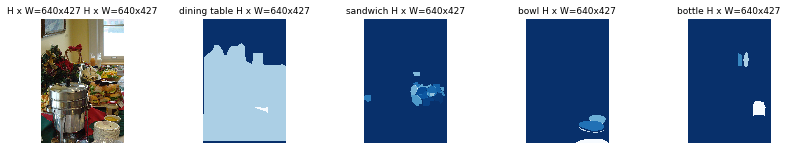

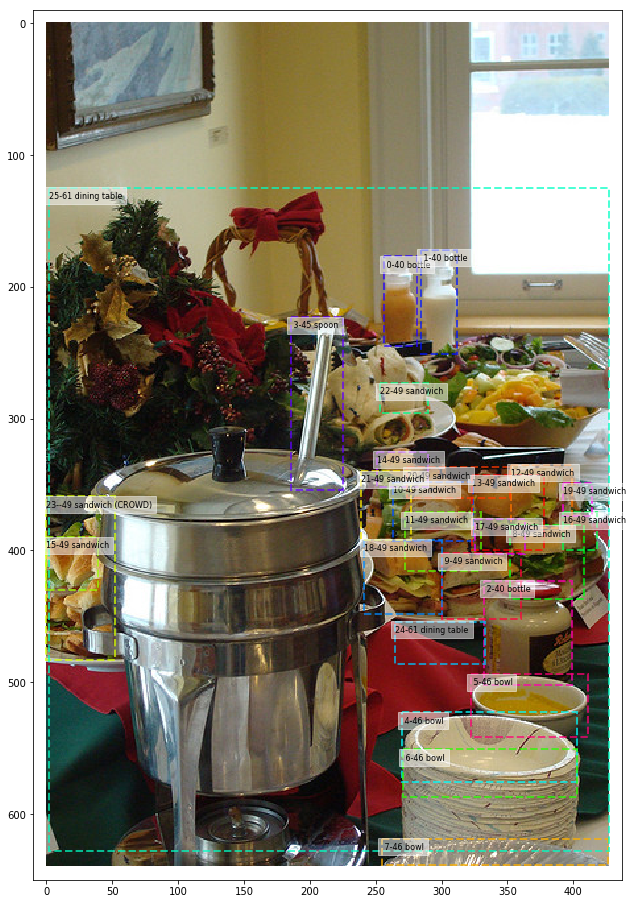

In [6]:

visualize.display_training_batch(dataset_test, train_batch_x)

#### Load a specific image using image_id

 load image ud:  50494
 Image_id    :  50494  Reference:  http://cocodataset.org/#explore?id=510642 Coco Id: 510642
 Image meta [50494   640   427     3     0   170  1024   853     1     1]
 Class ids   :  (26,)    [ 40  40  40  45  46  46  46  46  49  49  49  49  49  49  49  49  49  49  49  49  49  49  49 -49
  61  61]
 Class Names :  ['bottle', 'bottle', 'bottle', 'spoon', 'bowl', 'bowl', 'bowl', 'bowl', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'sandwich', 'snowboard', 'dining table', 'dining table']


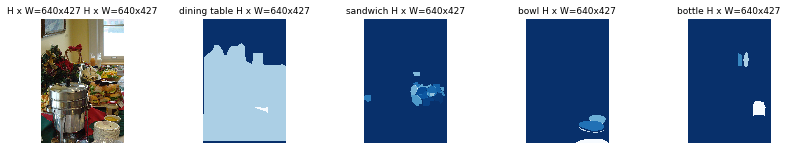

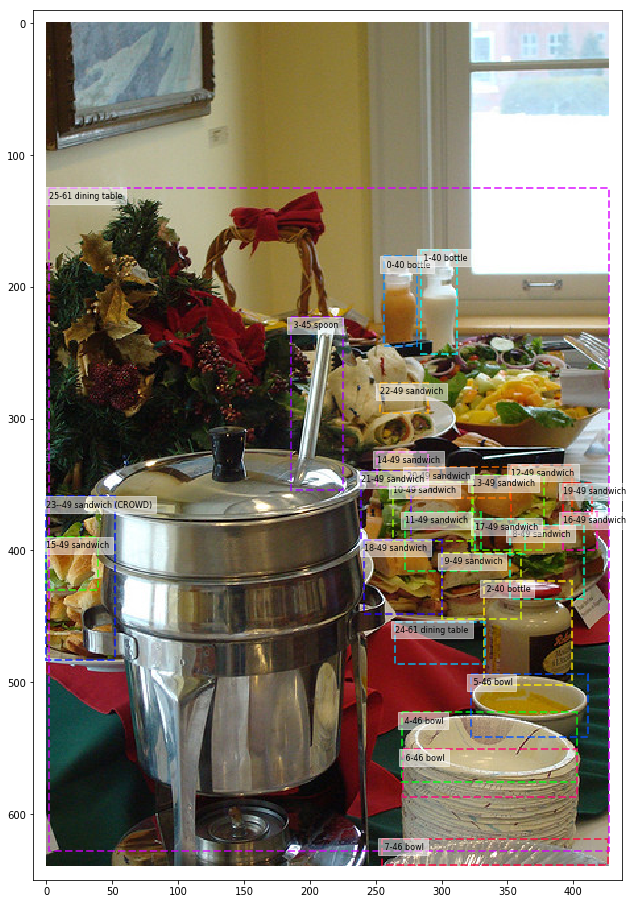

** Pass through MRCNN model:
/* Inputs */
Input  0:  (input_image:0                           ) 	  Input shape: (1, 1024, 1024, 3)
Input  1:  (input_image_meta:0                      ) 	  Input shape: (1, 89)

Requested layers:
-----------------
Layer   0:  (mrcnn_detection/detections:0            ) 	  Output shape: <unknown>
Layer   1:  (ROI/rpn_roi_proposals:0                 ) 	  Output shape: (1, ?, ?)
Layer   2:  (mrcnn_class_lambda/mrcnn_class:0        ) 	  Output shape: (?, 1000, 81)
Layer   3:  (mrcnn_bbox_lambda/mrcnn_bbox:0          ) 	  Output shape: (?, 1000, 81, 4)
Layer   4:  (cntxt_layer/pred_heatmap:0              ) 	  Output shape: (1, 256, 256, 81)
Layer   5:  (cntxt_layer/pred_heatmap_scores:0       ) 	  Output shape: (1, 81, 200, 24)


 config.DETECTION_MAX_INSTANCES:  200
 Detections shape: (32, 7)

/* Outputs */
Output idx:  0    Layer:  0: (mrcnn_detection/detections:0            ) 	  Output shape: (1, 200, 7)
Output idx:  1    Layer:  1: (ROI/rpn_roi_proposals:0

In [16]:
from mrcnn.prep_notebook import run_full_inference_pipeline, run_mrcnn_inference_pipeline
# IMAGE_LIST = []      ## 62642 (persons),   68539 (trucks)36466 (surfers)  75040 (boat and persons)
# IMAGE_LIST = [36466] ## 36466 surfers. 5498 basketbal players, 27711,30531
# IMAGE_LIST = [5498] lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
# IMAGE_LIST = [89243] ##: Person, bicycle and traiffic lights
# IMAGE_LIST = [35347] ## - people and skaeboard  
# IMAGE_LIST = [59199]  ## books , sofa, living room
# IMAGE_LIST = [102868]  ## person in an airplane
# IMAGE_LIST = [101623] ## (cake and forks)
IMAGE_LIST = [107200]   ## people, snow and skis
# IMAGE_LIST = [41423]  ## (elephant & people)
# IMAGE_LIST = [49316]  ## Table, book, backpack, many bottles
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]  ## Table, bowl, cup, sandwich, knife
# IMAGE_LIST = [29731]
# IMAGE_LIST = [26763]  ## Table, chair, cup , bowl, bottle
# mrcnn_input = demo_image(dataset_train, mrcnn_model.config, IMAGE_LIST)
# outputs = run_mrcnn_inference_pipeline(mrcnn_model, dataset_test, image_ids = [50494] , verbose = 1)
outputs = run_full_inference_pipeline(mrcnn_model, fcn_model, dataset_test, image_ids = [50494] , verbose = 1)

In [17]:
print(type(outputs), outputs.keys())

<class 'dict'> dict_keys(['mrcnn_input', 'image_batch', 'fcn_input', 'mrcnn_output', 'fcn_output'])


## Pass image through MRCNN and FCN

In [22]:
# mrcnn_model.layer_info()
# from mrcnn.prep_notebook import run_pipeline, run_pipeline_on_input
# mrcnn_output, fcn_output, fcn_input = run_pipeline_on_input(mrcnn_model, fcn_model, mrcnn_input, verbose = 0)

model_pr_heatmap                = outputs['mrcnn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
model_pr_heatmap_scores         = outputs['mrcnn_output'][1]          # layer:  1   shape: (1, 81, 200, 11)
model_gt_heatmap                = outputs['mrcnn_output'][2]          # layer:  2   shape: (1, 256, 256, 81)
model_gt_heatmap_scores         = outputs['mrcnn_output'][3]          # layer:  3   shape: (1, 81, 200, 11)
model_fcn_heatmap               = outputs['fcn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
model_fcn_softmax               = outputs['fcn_output'][1]          # layer:  1   shape: ()
model_fcn_scores                = outputs['fcn_output'][2]
# model_MSE_loss                  = outputs['fcn_output'][2]          # layer:  1   shape: ()
# model_CE_loss                   = outputs['fcn_output'][3]          # layer:  1   shape: ()
# print('model_pr_heatmap       : ',model_gt_heatmap.shape)
# print('model_pr_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_gt_heatmap       : ',model_gt_heatmap.shape)
# print('model_gt_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_fcn_heatmap      :', model_fcn_heatmap.shape)
# print('model_fcn_softmax      :', model_fcn_softmax.shape)
# print(model_CE_loss,model_MSE_loss)
img_id = 0
print('Image id: ',img_id, ' Coco ID: ', dataset_test.image_info[img_id]['id'])
gt_class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
pr_class_ids = np.unique(model_pr_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
print('Image : {}  Ground Truth ClassIds: {}'.format(img_id, gt_class_ids))
print('Image : {}  Predicted    ClassIds: {}'.format(img_id, pr_class_ids))

Image id:  0  Coco ID:  262146


IndexError: index 4 is out of bounds for axis 3 with size 4

## Display Heatmaps

### 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 31]
 rows   1  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


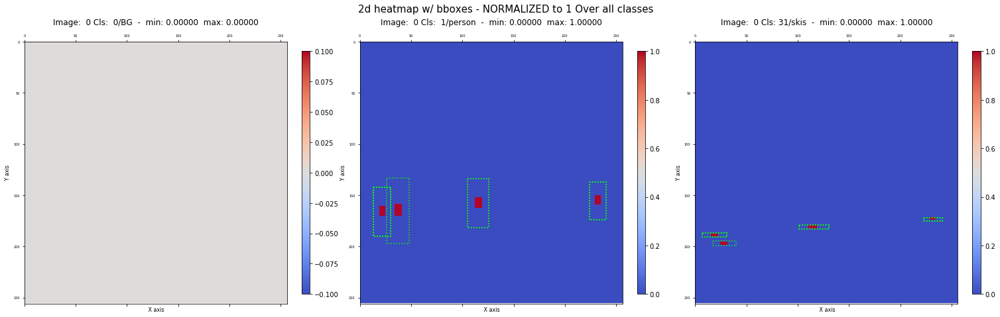

In [138]:
fig = visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                          class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


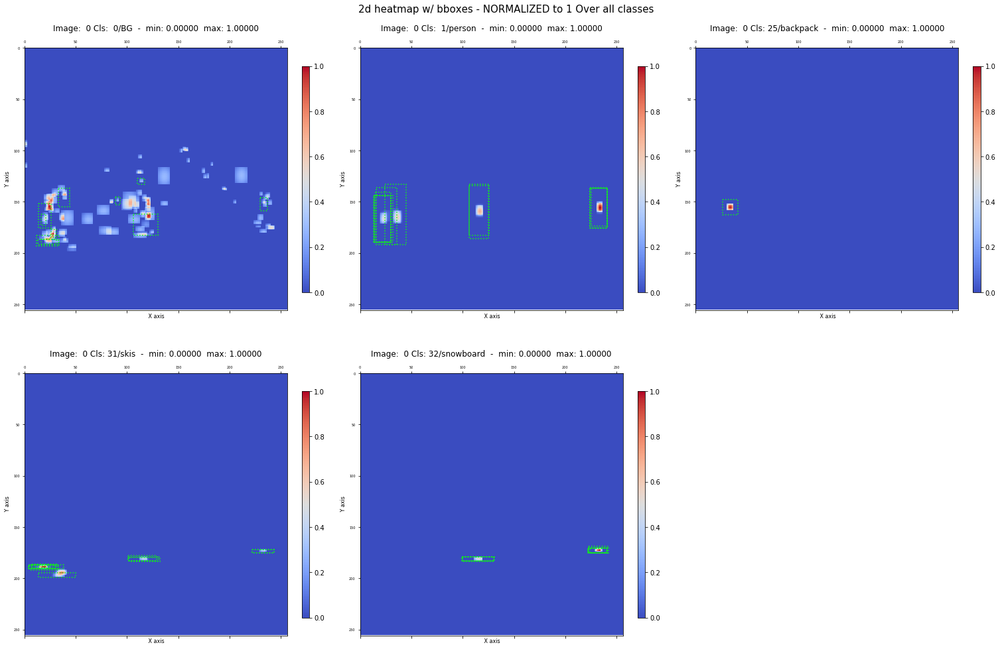

In [141]:
fig = visualize.plot_2d_heatmap(model_pr_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3, 
                            class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


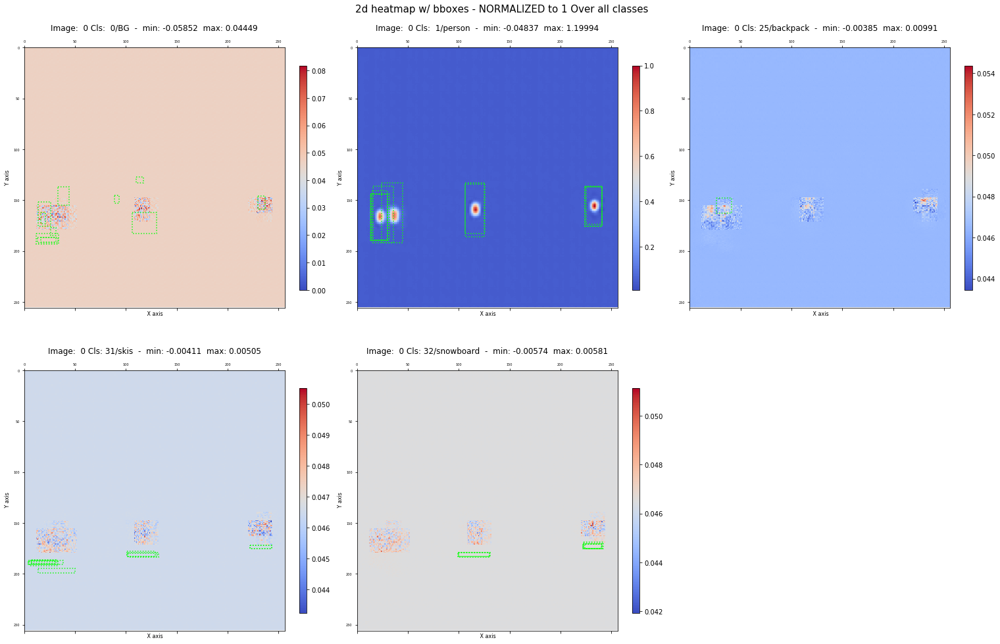

In [140]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3,
                          class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

 Image Id:  0  Display all classes...
 rows   27  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


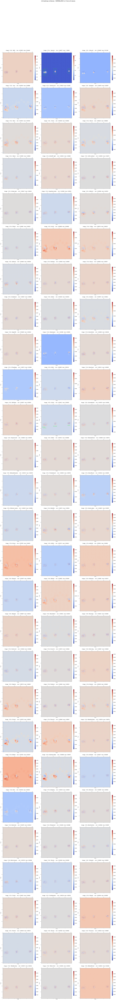

In [142]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

In [ ]:
fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

Display classes: [0, 1, 2, 3, 10]


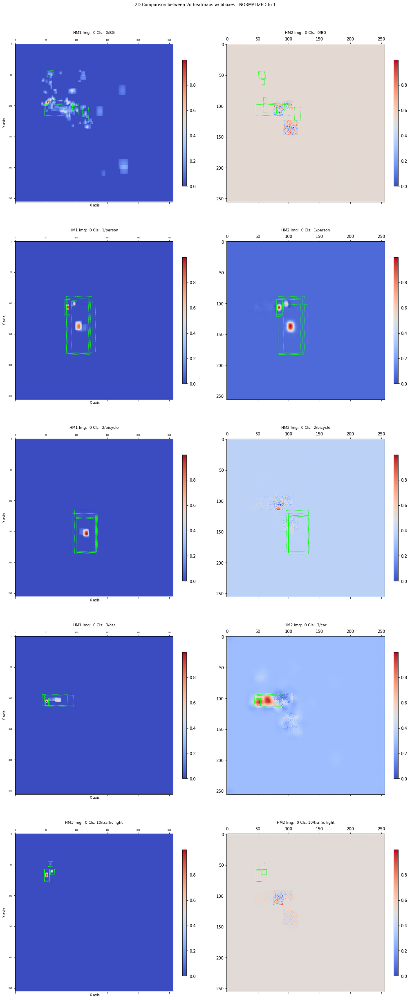

In [20]:
fig = visualize.plot_2d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, model_pr_heatmap_scores, 
                        img_id, class_ids = pr_class_ids, class_names = coco_class_names, scale = 4, scaling = True )    

###  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
zlim = all   zlim_min : 0.00000000 zlim_max: 1.00000000 
 SCALING == class


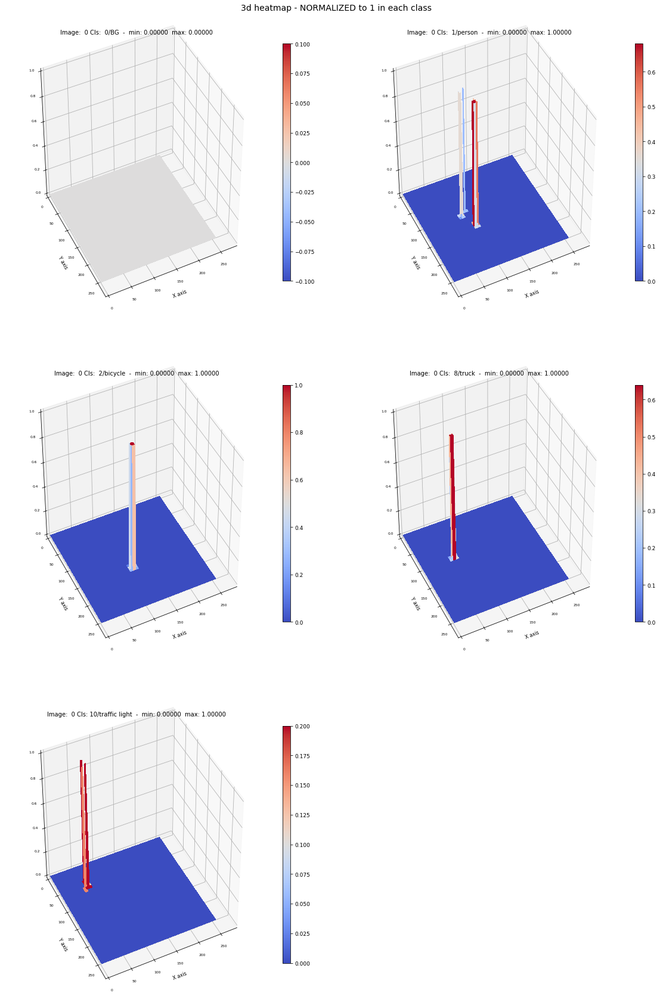

In [34]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap(model_gt_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling='class')

####  3D plot of `pred_heatmap_norm` returned form model

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 


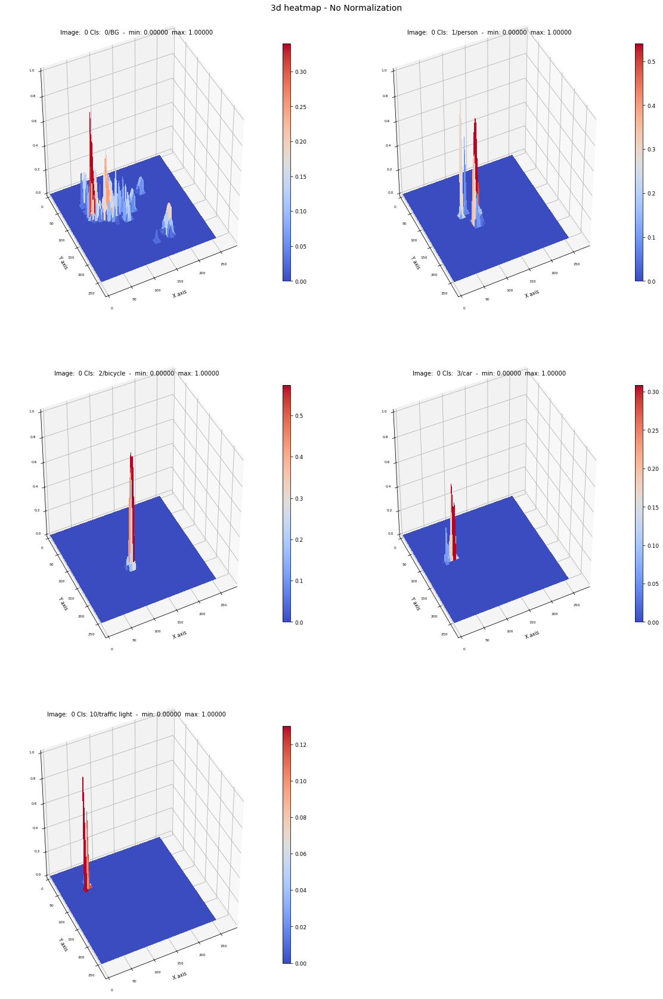

In [38]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_pr_heatmap, img_id, pr_class_ids, class_names = coco_class_names, zlim = 'class' , scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

1.0054814 -0.07213605
Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : -0.04918735 zlim_max: 0.04423909 
1 zlim = each  zlim_min : -0.07213605 zlim_max: 1.00548136 
1 zlim = each  zlim_min : -0.00786482 zlim_max: 0.01213216 
1 zlim = each  zlim_min : -0.00898363 zlim_max: 0.02093699 
1 zlim = each  zlim_min : -0.00705333 zlim_max: 0.00658484 


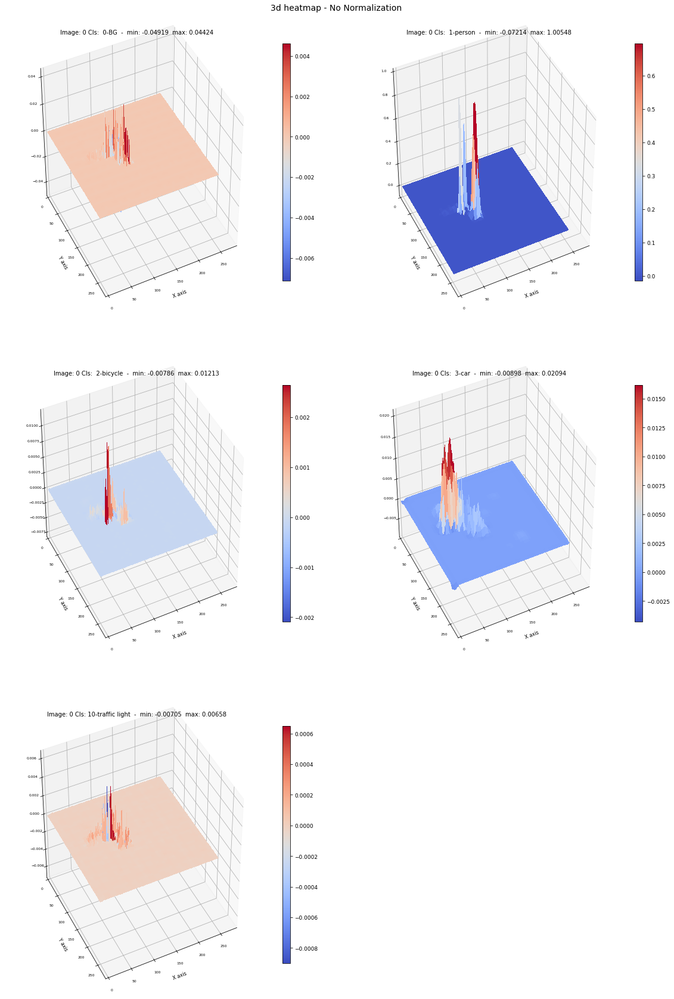

In [44]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, pr_class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - all classes

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display all classes...
rows   21  columns : 4
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all
zlim = all   zlim_min : -0.07213605 zlim_max: 1.00548136 


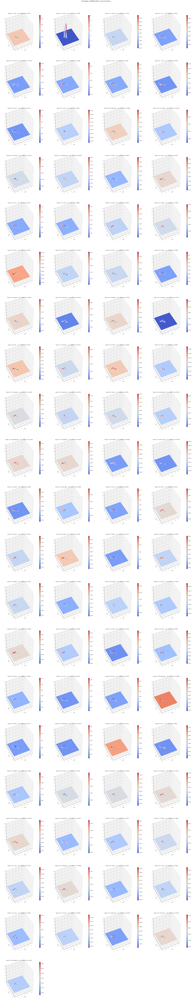

In [45]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = coco_class_names, columns = 3,scaling = 'all')

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, img_id, class_ids = pr_class_ids, 
                            class_names = coco_class_names, size=(8,8), zlim = 'all' , scaling = 'all')

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
 image height/width  256 256
shape pos  (256, 256, 2) shape Z1:  (256, 256, 81) shape Z2: (256, 256, 81)
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.07213605  max_z2_all: () max_z2_all: 1.0054814
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z1_cls shape: (1, 1, 81)  max_z1_cls shape: (1, 1, 81)
 min_z2_cls shape: (1, 1, 81)  max_z2_cls shape: (1, 1, 81)
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
ttl:  HM1 Img:  0 Cls:  0/BG  -  min: 0.00000  max: 0.00000
ttl:  HM2 Img:  0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
ttl:  HM1 Img:  0 Cls:  1/person  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  1/person  -  min: -0.07214  max: 1.00548
ttl:  HM1 Img:  0 Cls:  2/bicycle  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
ttl:  HM1 Img:  0 Cls:  8/t

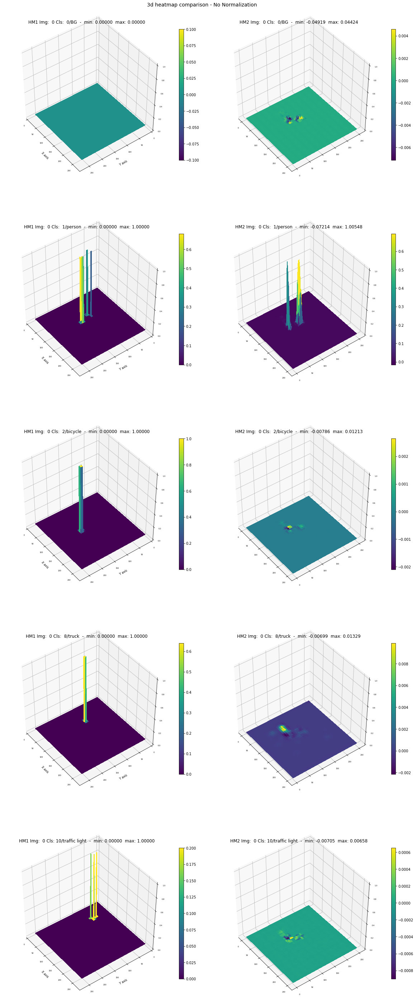

In [73]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap_compare(model_gt_heatmap, model_fcn_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling = 'none')

### Overlay predictions on image

#### Overlay image with gt_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  8 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


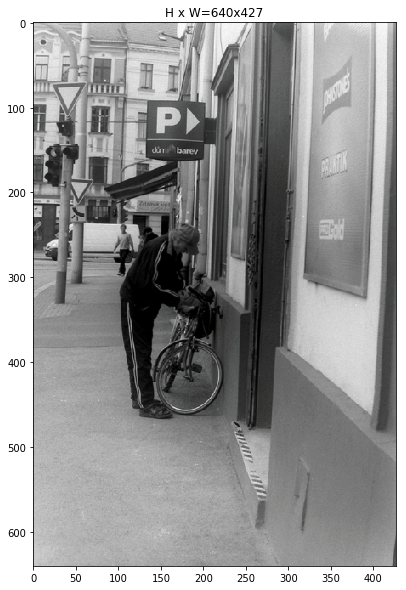

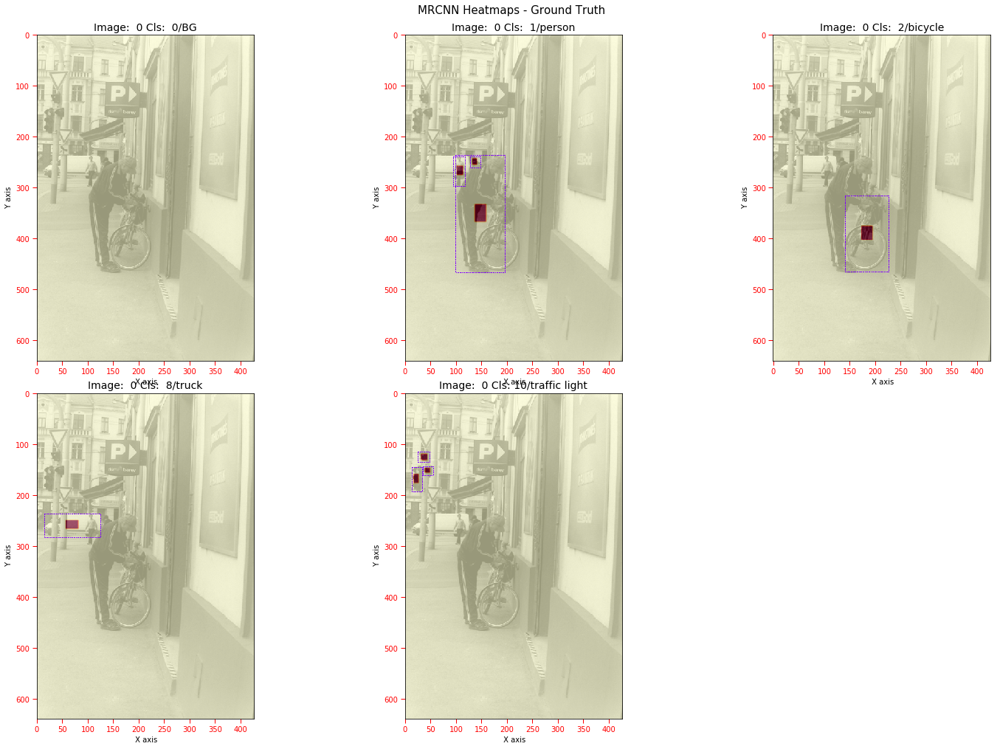

In [75]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'gt', columns = 3, 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  3 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


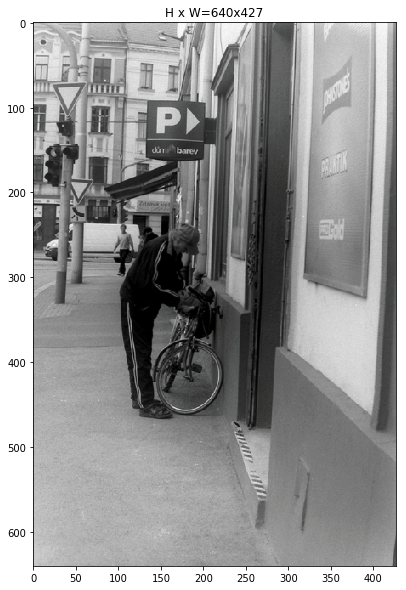

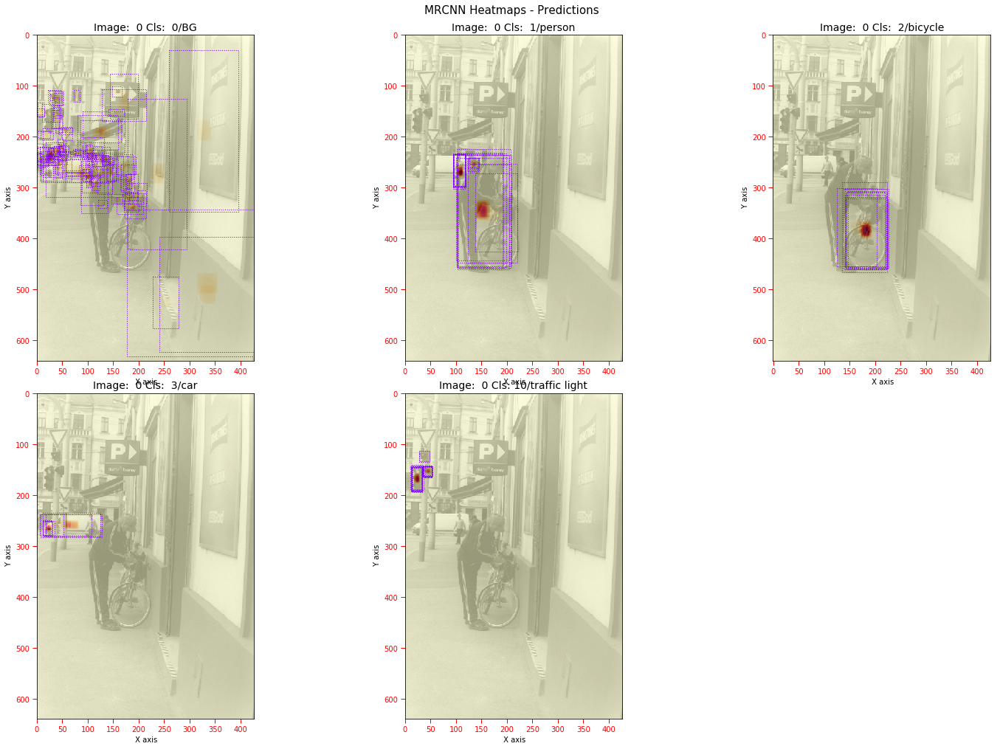

In [76]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'pr', columns = 3,
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 min_z_all:  () -0.07213605  max_z_all : () 1.0054814
 SCALING == none (clip to [-1, +1])
 Title:  Img: 0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
 Title:  Img: 0 Cls:  1/person  -  min: -0.07214  max: 1.00000
 Title:  Img: 0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
 Title:  Img: 0 Cls:  8/truck  -  min: -0.00699  max: 0.01329
 Title:  Img: 0 Cls: 10/traffic light  -  min: -0.00705  max: 0.00658


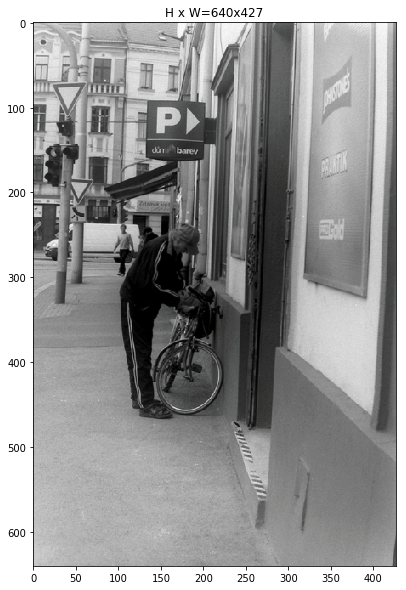

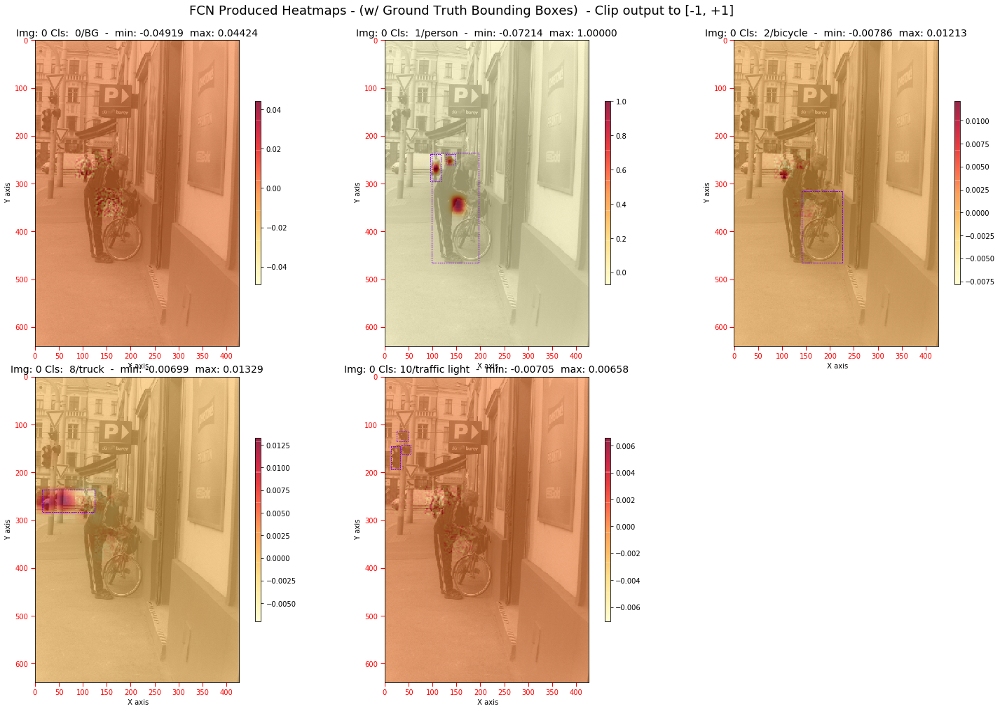

In [106]:
visualize.display_heatmaps_mrcnn_fcn(mrcnn_input, mrcnn_output, 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 3,
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

In [94]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: center;
}
</style>
""")

#### Overlay image with gt_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


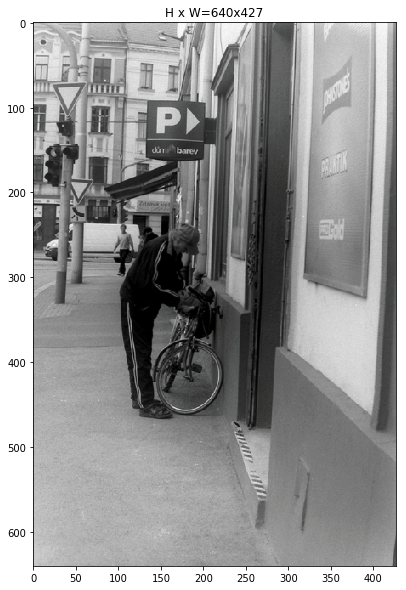

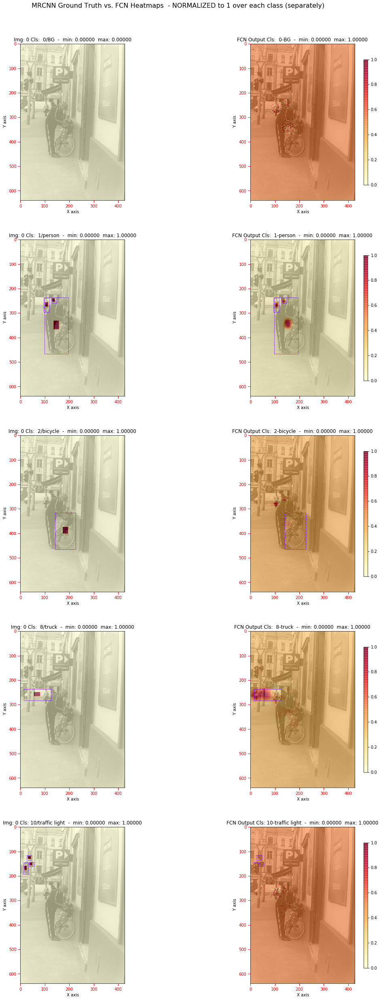

In [119]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, 
                                   hm = 'gt', config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

#### Overlay image with pr_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


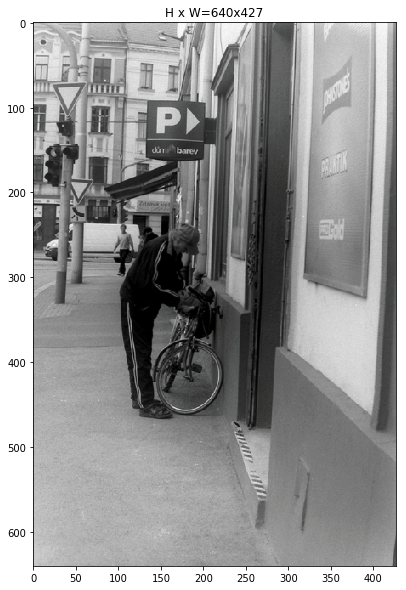

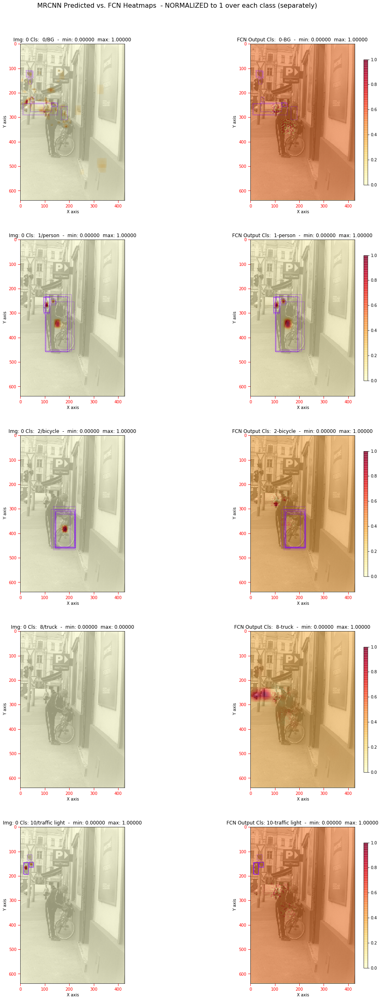

In [120]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, hm = 'pr', 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

##  Display `gauss_heatmap` 3D heatmap (not normalized, normlized, L2 normalized)

In [ ]:
from mrcnn.visualize import plot_3d_heatmap, plot_2d_heatmap, plot_3d_gaussian
%matplotlib inline
print('Image id: ',image_id , '    Classes (1: circle, 2: square, 3: triangle ): ')
img = 0
cls = 0
# print(pred_heatmap_scores[img,cls,:10])

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap_norm[img], title = ttl, width = 20)

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap_norm[img], title = ttl, width = 20)

ttl = 'Ground Truth Non-normalized - image: {}'.format(img)
# plot_3d_gaussian(model_fcn_heatmap[img,:,:,1], title = ttl, width = 10)
# ttl = 'Ground Truth Normalized - image: {}'.format(img)
plot_3d_heatmap(model_fcn_heatmap, 0,[9], title = ttl,width = 10, height=10, zlim=1.0005)


# ttl = 'Non-normalized - image: {}'.format(img)
# plot_2d_heatmap(pred_heatmap[img], pred_heatmap_scores[img], width=15, title=ttl)
# ttl = 'Normalized - image: {}'.format(img)
# plot_2d_heatmap(pred_heatmap_norm[img], pred_heatmap_scores[img], width=15, title=ttl)


In [ ]:
from mrcnn.visualize import plot_3d_heatmap, plot_2d_heatmap
%matplotlib inline
img = 0
cls = 1
# print(pred_heatmap_scores[img,cls,:10])

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(pred_heatmap_norm[img], title = ttl, width = 20)

# ttl = 'Non-normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap[img], title = ttl, width = 20)
# ttl = 'Normalized - image: {}'.format(img)
# plot_3d_heatmap(fcn_heatmap_norm[img], title = ttl, width = 20)

ttl = 'FCN - image: {}'.format(img)
plot_3d_heatmap(model_fcn_heatmap, 0,[9], title = ttl, size = (10,10))
ttl = 'Ground Truth Normalized - image: {}'.format(img)
plot_3d_heatmap(model_gt_heatmap,0,[9], title = ttl, size = (10,10))
